In [1]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
import matplotlib.pyplot as plt
import numpy as np
import os

In [2]:
# Load MNIST dataset
transform = transforms.Compose([
    transforms.Resize((28, 28)),
    transforms.ToTensor()
])
dataset = MNIST(root="./data", train=True, download=True, transform=transform)

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 9.91M/9.91M [00:00<00:00, 38.2MB/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 28.9k/28.9k [00:00<00:00, 1.18MB/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 1.65M/1.65M [00:00<00:00, 10.3MB/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 4.54k/4.54k [00:00<00:00, 7.74MB/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



In [3]:
def get_random_matrix(size=2):
    """Returns images (inverted) and numeric labels for a size×size random MNIST matrix."""
    indices = torch.randint(0, len(dataset), (size, size))
    matrix_images = [[1 - dataset[i][0].squeeze(0).numpy() for i in row] for row in indices]
    matrix_values = [[dataset[i][1] for i in row] for row in indices]
    return matrix_images, matrix_values

def draw_bracket(ax, x, y_bottom, y_top, side='left', bracket_width=10, linewidth=3):
    """
    Draws a single bracket at x (vertical line from y_bottom to y_top,
    plus horizontal lines at top and bottom).
    side='left' draws a bracket oriented like [ ; side='right' draws ].
    """
    if side == 'left':
        # top line goes from (x+bracket_width, y_top) to (x, y_top)
        # vertical line from (x, y_top) to (x, y_bottom)
        # bottom line from (x, y_bottom) to (x+bracket_width, y_bottom)
        lines = [
            ((x+bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x+bracket_width, y_bottom))
        ]
    else:
        # This is the "mirrored" bracket
        lines = [
            ((x-bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x-bracket_width, y_bottom))
        ]
    # Add each line to the plot
    for (start, end) in lines:
        ax.add_line(plt.Line2D([start[0], end[0]],
                               [start[1], end[1]],
                               color='black', linewidth=linewidth))

def plot_matrices(A_images, B_images, save_path=None):
    size = len(A_images)

    # Adjustable parameters
    cell_size     = 28   # MNIST digit is 28×28
    cell_spacing  = 8    # gap between columns/rows within each matrix
    matrix_gap    = 40   # gap between Matrix A and Matrix B
    bracket_width = 10   # how far brackets extend horizontally
    bracket_lw    = 3    # line thickness for the brackets

    fig, ax = plt.subplots(figsize=(size*3, size*3))
    ax.axis('off')

    # A helper to get the (left, right, bottom, top) extent for each digit
    def cell_extent(row, col, x_offset=0):
        left   = col * (cell_size + cell_spacing) + x_offset
        right  = left + cell_size
        top    = -row * (cell_size + cell_spacing)
        bottom = top - cell_size
        return (left, right, bottom, top)

    # Overall width/height of one matrix
    matrix_width  = size * (cell_size + cell_spacing) - cell_spacing
    matrix_height = size * (cell_size + cell_spacing) - cell_spacing

    # --- Plot Matrix A ---
    for i in range(size):
        for j in range(size):
            ax.imshow(A_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=0))

    # --- Plot Matrix B ---
    x_offset_B = matrix_width + matrix_gap
    for i in range(size):
        for j in range(size):
            ax.imshow(B_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=x_offset_B))

    # --- Draw brackets around Matrix A ---
    # Matrix A spans x from 0 to matrix_width, y from -matrix_height to 0
    # So we can bracket at x=-10 and x=matrix_width+10, from y_bottom = -matrix_height to y_top = 0
    y_top_A = 0
    y_bot_A = -matrix_height
    draw_bracket(ax, x=-10,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=matrix_width+10,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # --- Draw brackets around Matrix B ---
    # Matrix B spans x from x_offset_B to x_offset_B + matrix_width
    # So bracket it at x_offset_B - 10 and x_offset_B + matrix_width + 10
    y_top_B = 0
    y_bot_B = -matrix_height
    draw_bracket(ax, x=x_offset_B-10,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=x_offset_B+matrix_width+10,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # Let Matplotlib fit everything.
    ax.autoscale()

    # If we have a file path to save to, do it before showing.
    if save_path is not None:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")

    plt.show()

def save_matrix_data(set_name, num_samples, size):
    """Generate, plot, and save matrix multiplication data."""
    os.makedirs(f"dataset/{set_name}/images", exist_ok=True)
    labels = []

    for i in range(num_samples):
        A_images, A_values = get_random_matrix(size)
        B_images, B_values = get_random_matrix(size)

        # Compute matrix multiplication ground truth
        A_values_np = np.array(A_values)
        B_values_np = np.array(B_values)
        ground_truth = np.matmul(A_values_np, B_values_np)

        # Save images
        img_path = f"dataset/{set_name}/images/{size}x{size}_{i}.png"
        plot_matrices(A_images, B_images, save_path=img_path)

        # Store ground truth result
        labels.append(ground_truth)

    # Save labels to .npy file
    np.save(f"dataset/{set_name}/labels_{size}x{size}.npy", np.array(labels))

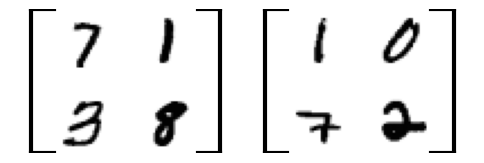

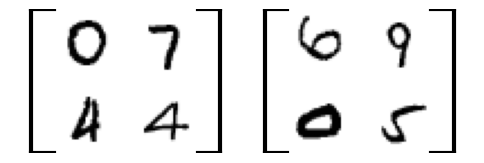

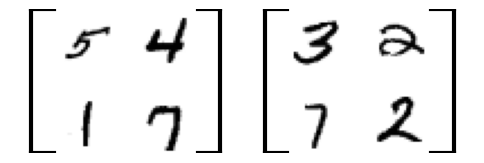

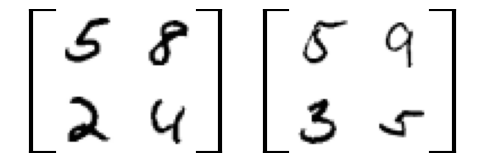

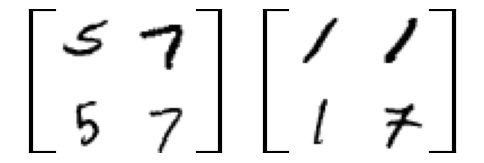

...

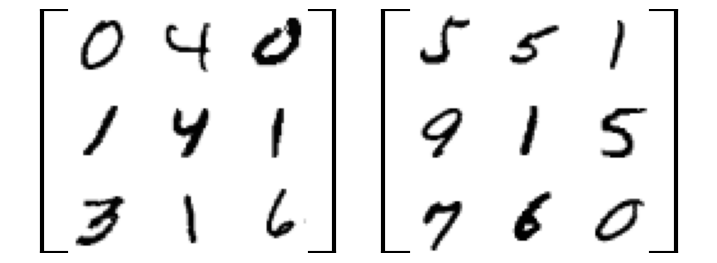

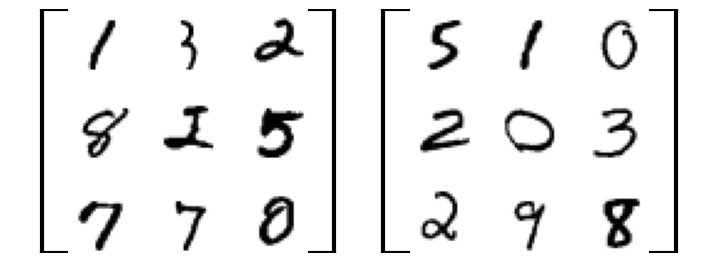

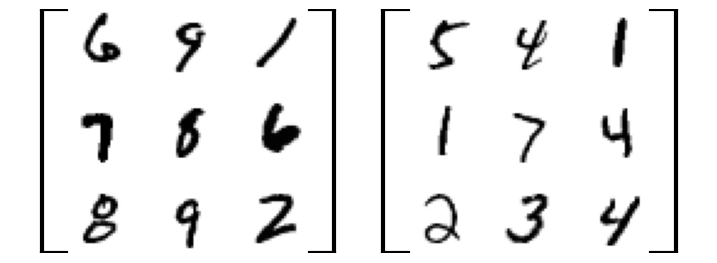

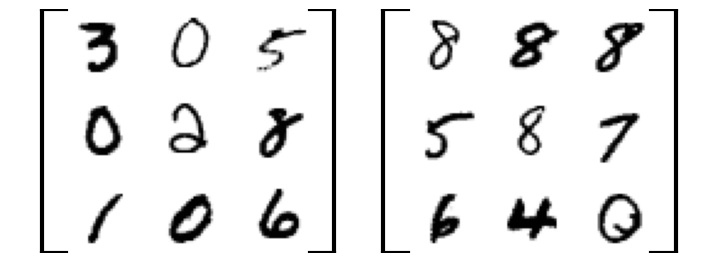

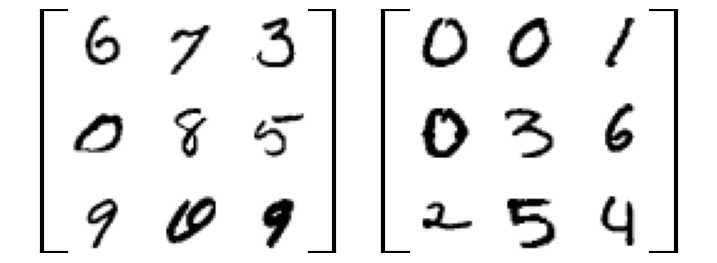

Dataset generation complete!


In [9]:
# Generate dataset
sizes = [2, 3]
dataset_splits = {"train": 400, "val": 50, "test": 50}

for split, num_samples in dataset_splits.items():
    for size in sizes:
        save_matrix_data(split, num_samples, size)

print("Dataset generation complete!")

In [10]:
!zip -r /content/dataset.zip /content/dataset/

  adding: content/dataset/ (stored 0%)
  adding: content/dataset/train/ (stored 0%)
  adding: content/dataset/train/labels_2x2.npy (deflated 81%)
  adding: content/dataset/train/images/ (stored 0%)
  adding: content/dataset/train/images/3x3_390.png (deflated 41%)
  adding: content/dataset/train/images/3x3_139.png (deflated 42%)
  adding: content/dataset/train/images/2x2_155.png (deflated 37%)
  adding: content/dataset/train/images/2x2_70.png (deflated 37%)
  adding: content/dataset/train/images/3x3_323.png (deflated 42%)
  adding: content/dataset/train/images/2x2_232.png (deflated 36%)
  adding: content/dataset/train/images/2x2_378.png (deflated 36%)
  adding: content/dataset/train/images/2x2_106.png (deflated 37%)
  adding: content/dataset/train/images/3x3_350.png (deflated 40%)
  adding: content/dataset/train/images/2x2_97.png (deflated 38%)
  adding: content/dataset/train/images/2x2_165.png (deflated 36%)
  adding: content/dataset/train/images/3x3_280.png (deflated 41%)
  adding: co

In [11]:
from google.colab import files
files.download("/content/dataset.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [12]:
data = np.load("/content/dataset/val/labels_2x2.npy")
print(data)

[[[  5  22]
  [ 20  89]]

 [[ 48  14]
  [  6  21]]

 [[ 20   0]
  [ 16   8]]

 [[ 25  20]
  [ 10   8]]

 [[ 19  11]
  [ 25  16]]

 [[ 53  47]
  [111  93]]

 [[  0   0]
  [ 70  70]]

 [[ 49  18]
  [ 49  21]]

 [[  5   3]
  [ 76  12]]

 [[ 20  28]
  [ 13  11]]

 [[ 35  77]
  [ 14  74]]

 [[ 51  60]
  [ 46  48]]

 [[ 21  61]
  [  8  20]]

 [[ 72  52]
  [ 72  68]]

 [[117  75]
  [ 45  27]]

 [[ 24  38]
  [ 82  84]]

 [[ 37  78]
  [ 32  48]]

 [[ 48  51]
  [ 73  79]]

 [[ 26  54]
  [ 29  61]]

 [[ 94  91]
  [  9   7]]

 [[  0   0]
  [  8   2]]

 [[ 41  56]
  [ 72  75]]

 [[ 21   0]
  [ 49   0]]

 [[ 39  63]
  [ 34  56]]

 [[ 58  57]
  [ 51  54]]

 [[  7  18]
  [ 36  90]]

 [[ 73  66]
  [ 32  24]]

 [[ 21  32]
  [ 21  16]]

 [[ 37   5]
  [ 35  25]]

 [[ 48  44]
  [  0  14]]

 [[ 63  49]
  [ 54  42]]

 [[ 20  14]
  [ 48  48]]

 [[ 48   7]
  [ 75  28]]

 [[ 38  15]
  [ 47  15]]

 [[ 60  25]
  [ 32   7]]

 [[ 11   4]
  [ 64  36]]

 [[  1   8]
  [ 14  77]]

 [[ 32  16]
  [ 28  19]]

 [[ 28  76]
